In [1]:
import matplotlib.pyplot as plt
from spider import SPIDER
op = SPIDER()
import anndata
import scanpy as sc
import squidpy as sq
import pandas as pd
import numpy as np

# use cpus only
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '-1'
TF_ENABLE_ONEDNN_OPTS = 0

2023-09-22 14:25:00.493303: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-09-22 14:25:00.495859: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-09-22 14:25:00.547233: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-09-22 14:25:00.548246: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-22 14:25:01.780413: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Co

In [2]:
sample_name = 'mousebrain'
ds = 'slide-seq-v2'
out_f = f'../input_datasets/{ds}/{sample_name}/'
adata = anndata.read_h5ad(f'{out_f}/adata.h5ad')
out_f = f'../datasets/{ds}/{sample_name}/'


In [3]:
adata

AnnData object with n_obs × n_vars = 41786 × 4000
    obs: 'barcode', 'x', 'y', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_MT', 'log1p_total_counts_MT', 'pct_counts_MT', 'n_counts', 'leiden', 'cluster'
    var: 'MT', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'cluster_colors', 'cluster_key', 'coord_type', 'gearyC', 'hvg', 'is_human', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'spatial_neighbors', 'umap'
    obsm: 'X_pca', 'X_umap', 'deconvolution_results', 'spatial'
    varm: 'PCs'
    obsp: 'connectivities', 'distances', 'spatial_connectivities', 'spatial_distances'

In [4]:
adata.obsm['deconvolution_results']

,Interneurons,Subiculum_Entorhinal_cl2,Subiculum_Entorhinal_cl3,DentatePyramids,CA1_CA2_CA3_Subiculum,Mural,Astrocytes,Oligodendrocytes,Polydendrocytes,Microglia,Ependymal,Endothelial_Tip,Neurogenesis,Endothelial_Stalk,barcode,max_cell_type,maxval,thresh_ct
AACGTCATAATCGT,0.113249,0.203010,0.086060,0.247319,0.153769,0.002455,0.072134,0.022327,0.008712,0.065562,0.003853,0.000000,0.000000,0.021550,AACGTCATAATCGT,4,0.247319,0.0
TACTTTAGCGCAGT,0.055718,0.077973,0.048517,0.187755,0.195889,0.040198,0.126317,0.071605,0.052353,0.013668,0.016075,0.044060,0.012159,0.057714,TACTTTAGCGCAGT,5,0.195889,0.0
CATGCCTGGGTTCG,0.108751,0.228845,0.109581,0.246070,0.115723,0.006306,0.071186,0.015768,0.000000,0.059735,0.000000,0.013702,0.000000,0.024332,CATGCCTGGGTTCG,4,0.246070,0.0
TCGATATGGCACAA,0.108163,0.029694,0.112905,0.172960,0.122573,0.014295,0.065901,0.031834,0.096153,0.034155,0.094124,0.065322,0.011114,0.040808,TCGATATGGCACAA,4,0.172960,0.0
TTATCTGACGAAGC,0.065790,0.236463,0.012458,0.233441,0.145091,0.014810,0.097935,0.052590,0.023642,0.008578,0.014275,0.058715,0.000000,0.036213,TTATCTGACGAAGC,2,0.236463,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CACCCGATGACTCC,0.189667,0.000000,0.000000,0.037157,0.007935,0.000000,0.000000,0.246184,0.392414,0.094163,0.000000,0.000000,0.016853,0.015627,CACCCGATGACTCC,9,0.392414,0.0
CTTGATTAGGCAGG,0.375533,0.123520,0.000000,0.036172,0.003471,0.000000,0.033918,0.006818,0.024570,0.308541,0.000000,0.078775,0.008685,0.000000,CTTGATTAGGCAGG,1,0.375533,0.0
GAGTTCCTAAGCGG,0.063493,0.050532,0.135440,0.349993,0.257504,0.000000,0.116491,0.000000,0.019085,0.000000,0.000000,0.000000,0.007462,0.000000,GAGTTCCTAAGCGG,4,0.349993,0.0
GCGCTCAGTGCTCT,0.313457,0.000000,0.000000,0.324040,0.061320,0.032552,0.000000,0.000000,0.086062,0.000000,0.000000,0.000000,0.000000,0.182568,GCGCTCAGTGCTCT,4,0.324040,0.0


running results

In [ ]:
# R_path = 

# no_spatalk = False
# if len(adata) > 10000:
#     no_spatalk=True
# idata = op.prep(adata, out_f, R_path, cluster_key=adata.uns['cluster_key'], is_human=adata.uns['is_human'], coord_type=adata.uns['coord_type'], no_spatalk=no_spatalk)
# idata, meta_idata = op.find_svi(idata, out_f, R_path, alpha=0.3)
# idata.write_h5ad(f'{out_f}/idata.h5ad')


or read results

In [3]:
idata = anndata.read_h5ad(f'{out_f}/idata.h5ad')

metrics

Using the results from SVI identification methods: ['SOMDE' 'SpatialDE' 'SPARKX' 'nnSVG' 'scGCO' 'gearyC' 'moranI']
188/188 SVIs identified (threshold=0.01).
evaluating with ['moranI' 'gearyC' 'SOMDE' 'nnSVG']


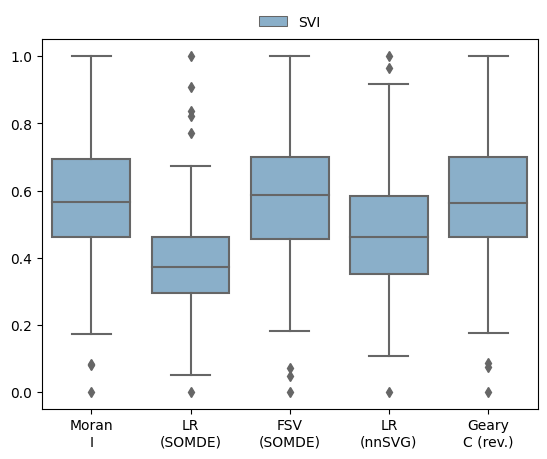

In [4]:
svi_df, svi_df_strict = op.svi.combine_SVI(idata,threshold=0.01)
op.svi.eva_SVI(idata, svi_df_strict)
plt.savefig(f'../figures/{ds}_{sample_name}_metric.png', dpi=100,bbox_inches='tight')

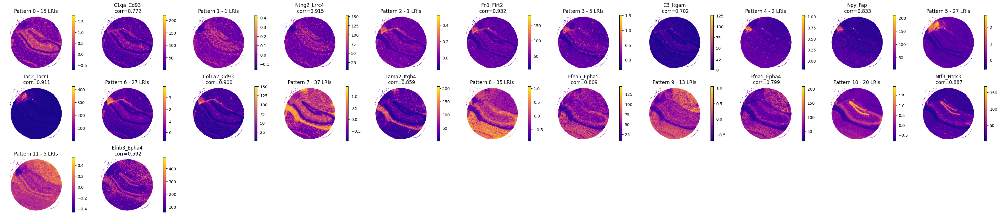

In [5]:
op.vis.pattern_LRI(idata,show_SVI=1, spot_size=1)
plt.tight_layout()

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

9_non-member vs. 9_member: Mann-Whitney-Wilcoxon test smaller with Benjamini-Hochberg correction, P_val:1.410e-08 U_stat=8.600e+01
10_non-member vs. 10_member: Mann-Whitney-Wilcoxon test smaller with Benjamini-Hochberg correction, P_val:8.485e-13 U_stat=5.600e+01
11_non-member vs. 11_member: Mann-Whitney-Wilcoxon test smaller with Benjamini-Hochberg correction, P_val:1.200e-06 U_stat=2.400e+01
8_non-member vs. 8_member: Mann-Whitney-Wilcoxon test smaller with Benjamini-Hochberg correction, P_val:3.511e-17 U_stat=2.530e+02
1_non-member vs. 1_member: Mann-Whitney-Wilcoxon test smaller with Benjamini-Hochberg correction, P_val:5.319e-03 U_stat=0.000e+00
0_non-member vs. 0_member: Mann-Whitney-Wilcoxon test smaller with Benjamini-Hochberg correction, P_val:2.161e-09 U_stat=1.100e+02
2_non-member vs. 2_member: Ma

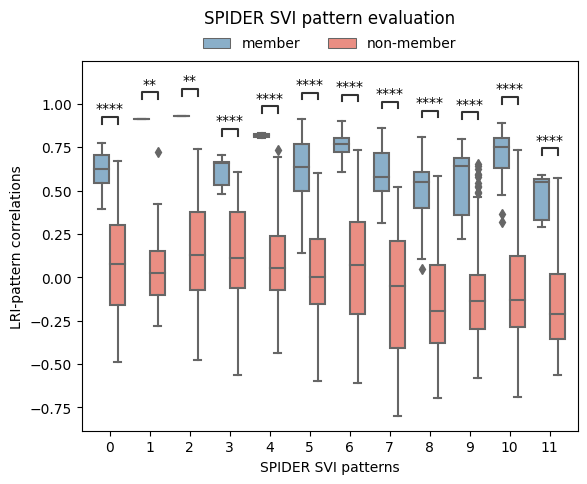

In [6]:
op.svi.eva_pattern(idata)
plt.xlabel('SPIDER SVI patterns')
plt.title('SPIDER SVI pattern evaluation', y=1.08)
plt.ylabel('LRI-pattern correlations')
plt.rcParams['font.size'] = 13


Using mouse LR pair dataset.
No objects to concatenate
No objects to concatenate
No objects to concatenate


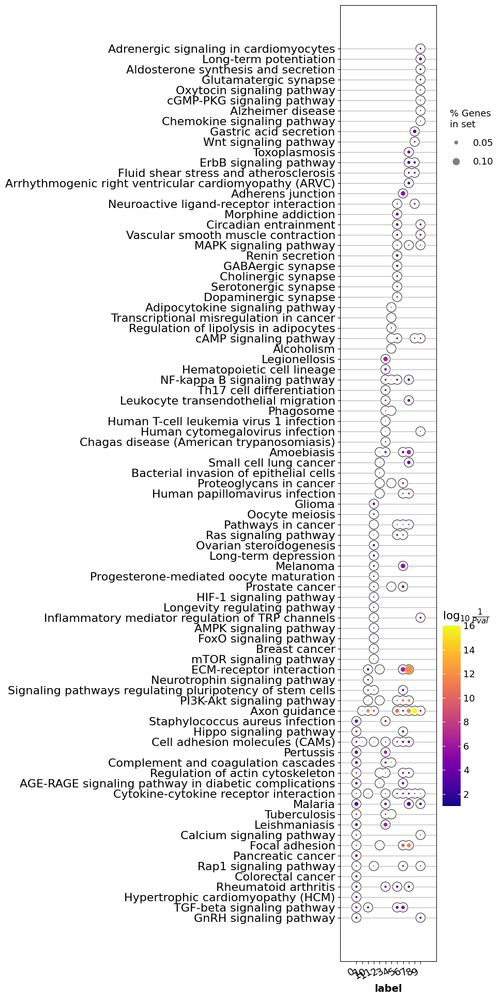

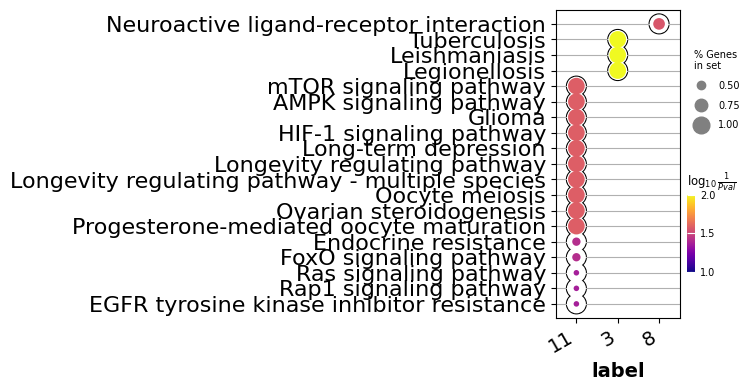

In [8]:
merged_df_edge, arr = op.er.pattern_enrichment_edge(idata,is_human=adata.uns['is_human'])
merged_df_node, arr = op.er.pattern_enrichment_node(idata,is_human=adata.uns['is_human'])
op.vis.enrichment(merged_df_node,x_key='label', cutoff=0.05, top_term=20,size=15)
merged_df_edge = merged_df_edge[~merged_df_edge['Term'].str.contains('cancer|Melanoma')]
try:
    plt.rcParams['font.size'] = 7
    op.vis.enrichment(merged_df_edge,x_key='label', cutoff=0.05, top_term=20, size=2, figsize=(2, 4))
except Exception as e:
    print(e)

In [9]:
idata = idata[:, idata.var['is_svi']==1]

In [10]:
adata, adata_lri, adata_pattern = op.cell_transform(idata, adata, label=adata.uns['cluster_key'])
adata_lri.obsm['spatial'] = adata[adata_lri.obs_names].obsm['spatial']
adata_pattern.obsm['spatial'] = adata[adata_lri.obs_names].obsm['spatial']

Added key cell_pattern in idata.uns
Added key cell_score in idata.uns
Added key interaction_pattern, interaction_score in adata.obsm
Added key rank_interaction_score_groups, rank_interaction_pattern_groups in adata.uns


         Falling back to preprocessing with `sc.pp.pca` and default params.


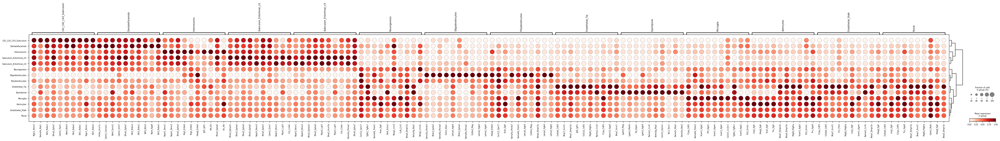

In [11]:
with plt.rc_context():
    sc.pl.rank_genes_groups_dotplot(adata_lri, standard_scale='var', show=False)
    plt.savefig(f'../figures/{ds}_{sample_name}_label_SVI.png', bbox_inches="tight")

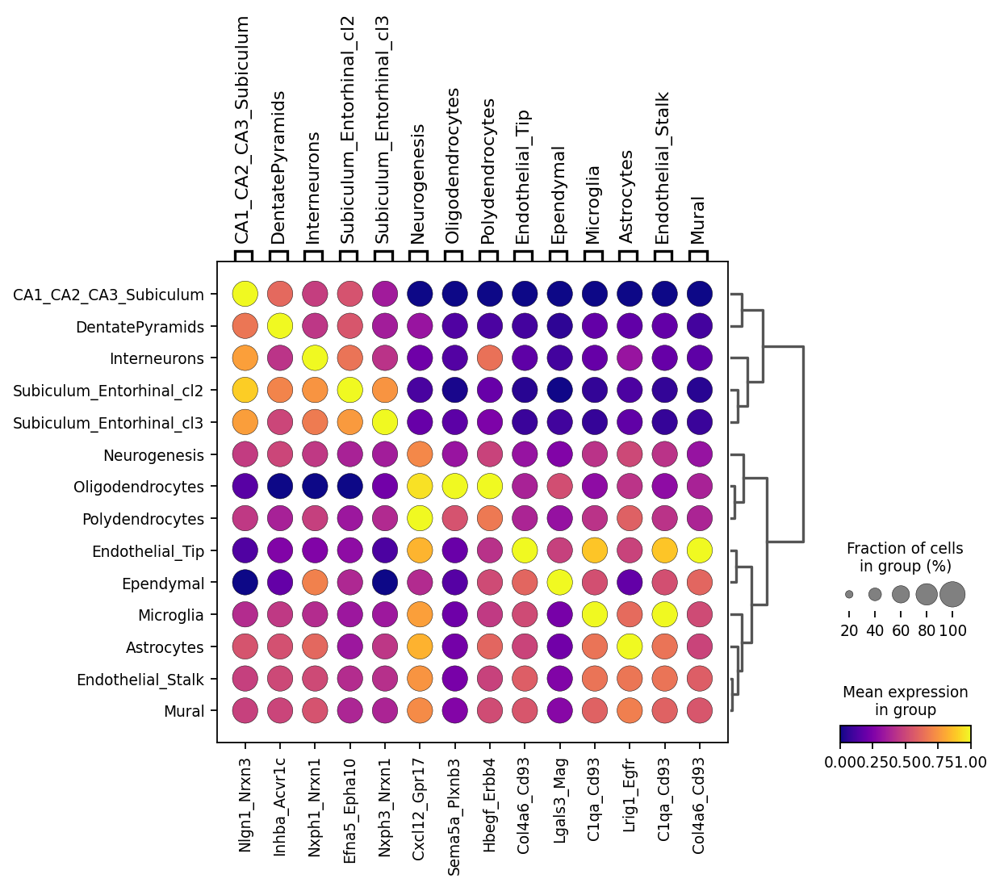

In [12]:
with plt.rc_context():
    sc.set_figure_params(figsize=(3, 3), fontsize=10)
    sc.pl.rank_genes_groups_dotplot(adata_lri, standard_scale='var', show=False, cmap='plasma', n_genes=1)
    plt.savefig(f'../figures/{ds}_{sample_name}_label_SVI1.png', bbox_inches="tight")

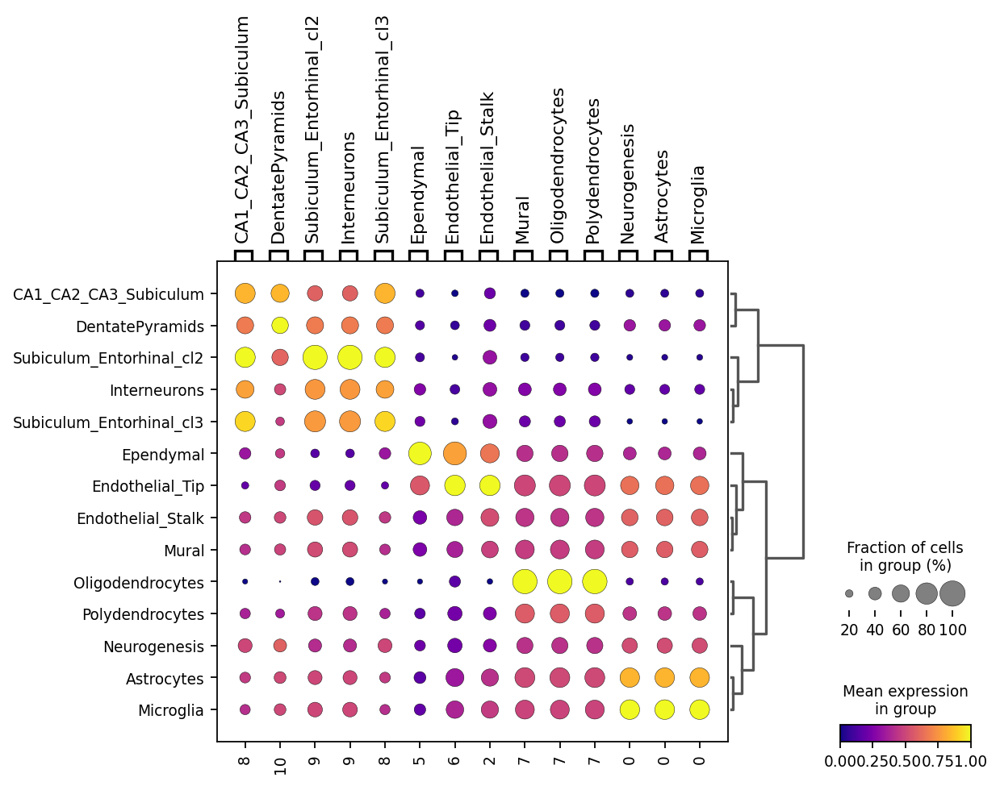

In [13]:
with plt.rc_context(): 
    sc.set_figure_params(figsize=(3, 3), fontsize=10)
    sc.pl.rank_genes_groups_dotplot(adata_pattern, standard_scale='var', n_genes=1, show=False, cmap='plasma')
    plt.savefig(f'../figures/{ds}_{sample_name}_label_pattern.png', bbox_inches="tight")


In [14]:
sq.gr.spatial_neighbors(adata, key_added='spatial')
sq.gr.spatial_autocorr(
    adata,
    genes=adata.var_names,
    mode="moran",
    n_perms=1000,
    n_jobs=1,
)


100%|██████████| 1000/1000 [24:12<00:00,  1.45s/]


Mouse KEGG_2019_Mouse
Using mouse LR pair dataset.
50
0.29785379706656556 0.1348194701533406 0.05903925181915221


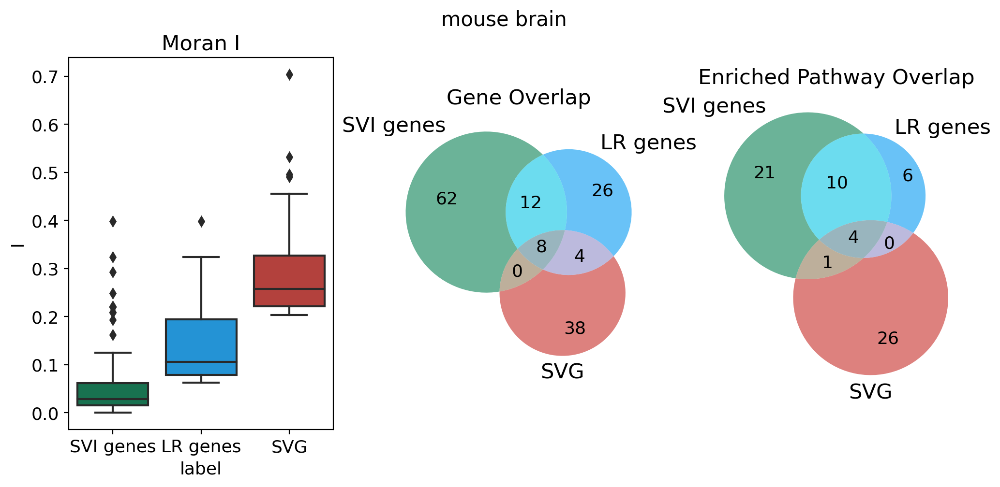

In [15]:
plt.rcParams['font.size'] = 13
merged_df,lri_pw_list,gene_lr_list,gene_pw_list = op.vis.svg_svi_relation(adata, idata, title='mouse brain', is_human=adata.uns['is_human'], top=50)
plt.savefig(f'../figures/{ds}_{sample_name}_relation.png', dpi=100,bbox_inches='tight')


In [16]:
region = adata.obsm['deconvolution_results'].loc[adata_pattern.obs_names]
from scipy import stats
pds = []
for i in adata_pattern.var_names:
    pds.append(region.corrwith(adata_pattern.to_df()[i].astype('float'), method=stats.pointbiserialr)[:1])
pds_df = pd.concat(pds)
pds_df.index = adata_pattern.var_names
useful_df = []
for cluster_i in adata.obs['cluster'].unique():
    df_sub = pds_df[pds_df[cluster_i]>0.3][cluster_i].sort_values(ascending=False)
    if len(df_sub) > 0:
        useful_df.append(df_sub)

In [17]:
patterns = []
cluster = []
cluster_id = []
corrs = []
cluster_id_map = {
    'DentatePyramids': 'Dentate Pyramids',
    'Endothelial_Tip': 'Endothelial Tip',
    'Oligodendrocytes': 'Oligodendrocytes',
    'Astrocytes': 'Astrocytes',
    'Ependymal': 'Ependymal',
    'CA1_CA2_CA3_Subiculum': "CA1/CA2/CA3 Subiculum",
    'Subiculum_Entorhinal_cl2': "Subiculum Entorhinal cl2"
}
for x in useful_df:
    patterns.append(int(x.idxmax()))
    corrs.append(x.max())
    cluster_id.append(x.name)
    cluster.append(cluster_id_map[x.name])
patterns = np.array(patterns)[np.argsort(corrs)[::-1]]
cluster_id = np.array(cluster_id)[np.argsort(corrs)[::-1]]
cluster = np.array(cluster)[np.argsort(corrs)[::-1]]
corrs = np.array(corrs)[np.argsort(corrs)[::-1]]

['Ntf3_Ntrk3' 'Bdnf_Ntrk3' 'Slit1_Robo2' 'Slit3_Robo2']
['Lama2_Itgb4' 'Lama5_Itgb4' 'Col9a3_Mag' 'Lama1_Itgb4']
['C1qa_Cd93' 'Il16_Grin2c' 'Cfh_Itgam' 'Icam1_Itgam']
['Col1a2_Cd93' 'Igf2_Igf1r' 'Fn1_Col13a1' 'Cdh1_Ptprm']
['Efna5_Epha4' 'Efna5_Epha3' 'Nxph1_Nrxn3' 'Vip_Ramp3']
['Tac2_Tacr1' 'Tac1_Tacr1' 'Nppa_Npr1' 'Slit2_Robo3']
['Ntf3_Ntrk3' 'Bdnf_Ntrk3' 'Slit1_Robo2' 'Slit3_Robo2']


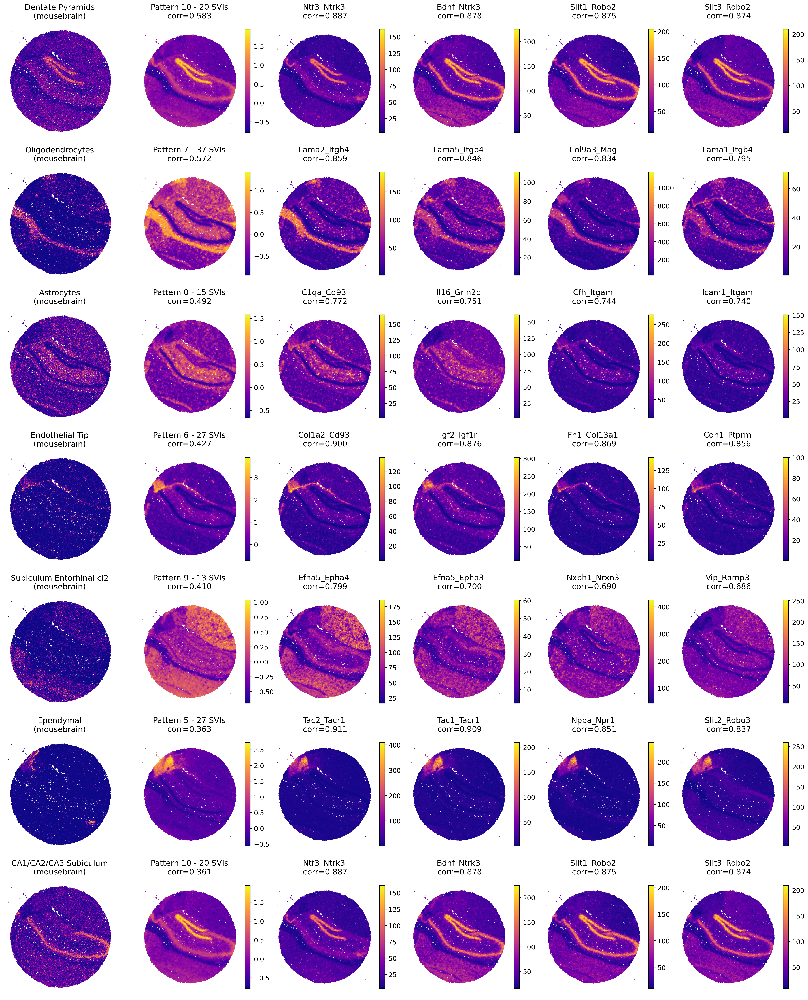

In [18]:
useful_df = []
adata_lri.obsm['spatial'] = adata[adata_lri.obs_names].obsm['spatial']
adata_pattern.obsm['spatial'] = adata[adata_lri.obs_names].obsm['spatial']

plt.figure(figsize=(7*4, 5*len(patterns)))
base = 1
for i in range(len(patterns)):
    corr =  corrs[i]
    cluster_name = cluster[i]
    cluster_i = cluster_id[i]

    plt.subplot(len(patterns), 6, base)

    plt.scatter(adata.obsm['spatial'][:,0],adata.obsm['spatial'][:,1], c=adata.obsm['deconvolution_results'][cluster_i], s=3, cmap='plasma', edgecolors='none')
    # plt.scatter(adata[adata.obs['cluster']==cluster_id].obsm['spatial'][:,0],adata[adata.obs['cluster']==cluster_id].obsm['spatial'][:,1], c=adata[adata.obs['cluster']==cluster_name].obs['cluster']==cluster_name, s=5, cmap='plasma', vmin=0, edgecolors='none')
    plt.axis('equal')
    plt.axis('off')
    plt.title(f'{cluster_name}\n({sample_name})')
    base += 1
    
    plt.subplot(len(patterns), 6, base)
    im=plt.scatter(adata_pattern.obsm['spatial'][:,0], adata_pattern.obsm['spatial'][:,1], c=adata_pattern.to_df()[str(patterns[i])], s=3, cmap='plasma', edgecolors='none')
    plt.colorbar(im,fraction=0.046, pad=0.04)
    plt.axis('equal')
    plt.axis('off')
    plt.title(f'Pattern {patterns[i]} - {np.sum(idata.var.label == patterns[i])} SVIs\ncorr={"%.3f" % corr}')
    base += 1
    
    svis = idata.var[idata.var.label == patterns[i]].sort_values(f'pattern_correlation_{patterns[i]}', ascending=False)
    svi_to_plot = svis.index.to_numpy()[:4]
    print(svi_to_plot)
    memberships = svis[f'pattern_correlation_{patterns[i]}'].to_numpy()[:4]
    for j in range(4):
        if j < len(svi_to_plot):
            plt.subplot(len(patterns), 6, base)
            im=plt.scatter(adata_lri.obsm['spatial'][:,0], adata_lri.obsm['spatial'][:,1], c=adata_lri.to_df()[svi_to_plot[j]], s=3, cmap='plasma', edgecolors='none',linewidths=0)
            plt.axis('equal')
            plt.axis('off')
            plt.colorbar(im,fraction=0.046, pad=0.04)
            plt.title(f'{svi_to_plot[j]}\n corr={"%.3f" % memberships[j]}')
        base += 1
plt.savefig(f'../figures/{ds}_{sample_name}_decon_pattern_full.png', dpi=100,bbox_inches='tight')

In [19]:
region = pd.get_dummies(idata.uns['cell_meta'].loc[adata.obs_names]['cluster']).loc[adata_pattern.obs_names]
from scipy import stats
pds = []
for i in adata_pattern.var_names:
    pds.append(region.corrwith(adata_pattern.to_df()[i].astype('float'), method=stats.pointbiserialr)[:1])
pds_df = pd.concat(pds)
pds_df.index = adata_pattern.var_names
useful_df = []
for cluster_i in adata.obs['cluster'].unique():
    df_sub = pds_df[pds_df[cluster_i]>0.3][cluster_i].sort_values(ascending=False)
    if len(df_sub) > 0:
        useful_df.append(df_sub)

In [20]:
useful_df

[10    0.302205
 Name: DentatePyramids, dtype: float64,
 7    0.450247
 Name: Oligodendrocytes, dtype: float64,
 0    0.327792
 Name: Astrocytes, dtype: float64,
 5    0.313545
 Name: Ependymal, dtype: float64,
 6    0.360728
 2    0.301425
 Name: Endothelial_Tip, dtype: float64]

In [21]:
patterns = []
cluster = []
cluster_id = []
corrs = []
cluster_id_map = {
    'DentatePyramids': 'Dentate Pyramids',
    'Endothelial_Tip': 'Endothelial Tip',
    'Oligodendrocytes': 'Oligodendrocytes',
    'Astrocytes': 'Astrocytes',
    'Ependymal': 'Ependymal'
}
for x in useful_df:
    patterns.append(int(x.idxmax()))
    corrs.append(x.max())
    cluster_id.append(x.name)
    cluster.append(cluster_id_map[x.name])

['Ntf3_Ntrk3' 'Bdnf_Ntrk3']
['Lama2_Itgb4' 'Lama5_Itgb4']
['C1qa_Cd93' 'Il16_Grin2c']
['Tac2_Tacr1' 'Tac1_Tacr1']
['Col1a2_Cd93' 'Igf2_Igf1r']


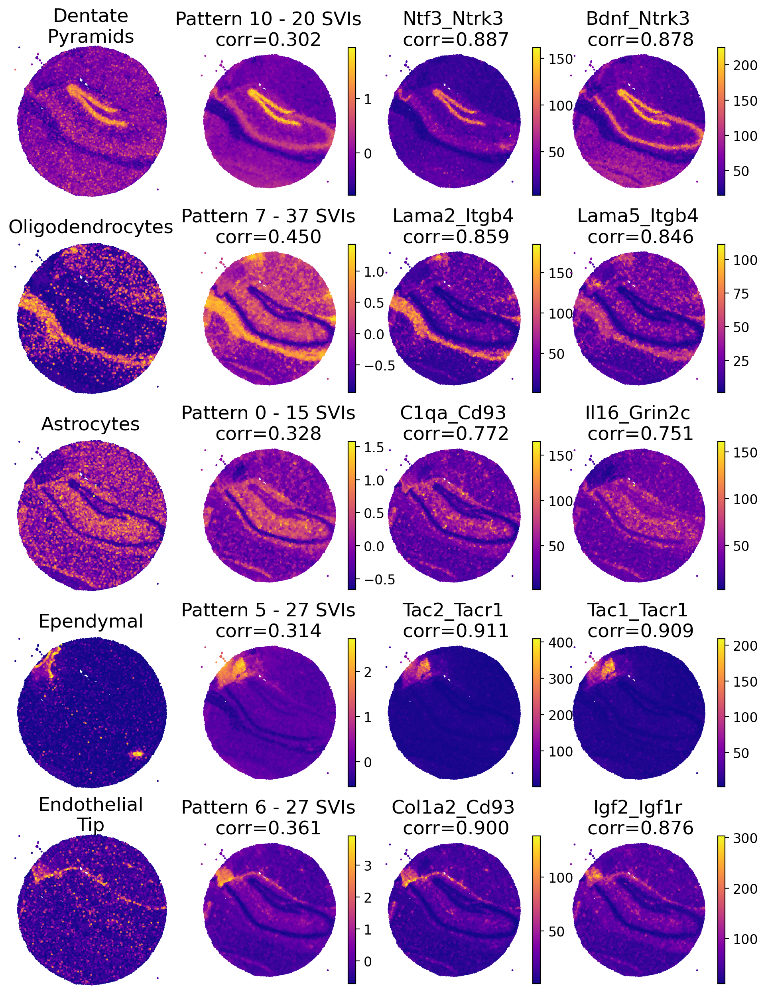

In [22]:
useful_df = []
adata_lri.obsm['spatial'] = adata[adata_lri.obs_names].obsm['spatial']
adata_pattern.obsm['spatial'] = adata[adata_lri.obs_names].obsm['spatial']

plt.figure(figsize=(4*4, 3.1*len(patterns)))
plt.rcParams['font.size'] = 12

base = 1
for i in range(len(patterns)):
    corr =  corrs[i]
    cluster_name = cluster[i]
    cluster_i = cluster_id[i]

    plt.subplot(len(patterns), 4, base)
    to_plot = pd.DataFrame(adata.obsm['deconvolution_results'][cluster_i])
    to_plot[['x','y']] = adata.obsm['spatial']
    to_plot = to_plot.sort_values(cluster_i, ascending=True)
    plt.scatter(to_plot['x'],to_plot['y'], c=to_plot[cluster_i], s=3, cmap='plasma', edgecolors='none')
    # plt.scatter(adata.obsm['spatial'][:,0],adata.obsm['spatial'][:,1], c=adata.obsm['deconvolution_results'][cluster_i], s=3, cmap='plasma', edgecolors='none')

    # plt.scatter(adata.obsm['spatial'][:,0],adata.obsm['spatial'][:,1], c=adata.obs['cluster']==cluster_i, s=3, cmap='plasma', edgecolors='none')
    # plt.scatter(adata[adata.obs['cluster']==cluster_id].obsm['spatial'][:,0],adata[adata.obs['cluster']==cluster_id].obsm['spatial'][:,1], c=adata[adata.obs['cluster']==cluster_name].obs['cluster']==cluster_name, s=5, cmap='plasma', vmin=0, edgecolors='none')
    plt.axis('equal')
    plt.axis('off')
    if cluster_name.__contains__(' '):
        plt.title(cluster_name.replace(" ", "\n", 1), y=0.94, fontsize=17)
    else:
        plt.title(cluster_name, y=0.98, fontsize=17)
    # plt.title(f'{cluster_name}\n({sample_name})', y=0.94, fontsize=17)
    base += 1
    
    plt.subplot(len(patterns), 4, base)
    im=plt.scatter(adata_pattern.obsm['spatial'][:,0], adata_pattern.obsm['spatial'][:,1], c=adata_pattern.to_df()[str(patterns[i])], s=3, cmap='plasma', edgecolors='none')
    plt.colorbar(im,fraction=0.046, pad=0.04)
    plt.axis('equal')
    plt.axis('off')
    plt.title(f'Pattern {patterns[i]} - {np.sum(idata.var.label == patterns[i])} SVIs\ncorr={"%.3f" % corr}', y=0.92, fontsize=17)
    base += 1
    
    svis = idata.var[idata.var.label == patterns[i]].sort_values(f'pattern_correlation_{patterns[i]}', ascending=False)
    svi_to_plot = svis.index.to_numpy()[:2]
    print(svi_to_plot)
    memberships = svis[f'pattern_correlation_{patterns[i]}'].to_numpy()[:2]
    for j in range(2):
        plt.subplot(len(patterns), 4, base)
        im=plt.scatter(adata_lri.obsm['spatial'][:,0], adata_lri.obsm['spatial'][:,1], c=adata_lri.to_df()[svi_to_plot[j]], s=3, cmap='plasma', edgecolors='none',linewidths=0)
        plt.axis('equal')
        plt.axis('off')
        plt.colorbar(im,fraction=0.046, pad=0.04)
        plt.title(f'{svi_to_plot[j]}\n corr={"%.3f" % memberships[j]}', y=0.92, fontsize=17)
        base += 1
plt.subplots_adjust(left=0.34,
                    wspace=0.15)
    
# plt.savefig(f'../figures/{ds}_{sample_name}_cluster_pattern.png', dpi=100,bbox_inches='tight')


In [23]:
cluster_name.replace(" ", "\n", 1)

'Endothelial\nTip'

In [24]:
group = idata.var[idata.var['is_svi']==1]
group['g'] = group.index
group['membership'] = 1
custom, background = op.er.pathway_prep(idata,is_human=False)
merged_df_edge, arr = op.er.enrichment(custom, background, group, groupby='label')


Using mouse LR pair dataset.


In [25]:
merged_df_edge[merged_df_edge.group=='11']

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Genes,group,ordered_group
0,gs_ind_0,AMPK signaling pathway,1/1,0.012048,0.026287,165.000000,Igf1_Igf1r,11,11
1,gs_ind_0,Breast cancer,1/1,0.012048,0.026287,165.000000,Igf1_Igf1r,11,11
2,gs_ind_0,EGFR tyrosine kinase inhibitor resistance,1/3,0.036145,0.043373,69.000000,Igf1_Igf1r,11,11
3,gs_ind_0,Endocrine resistance,1/2,0.024096,0.038554,97.800000,Igf1_Igf1r,11,11
4,gs_ind_0,Focal adhesion,1/10,0.120482,0.125720,21.000000,Igf1_Igf1r,11,11
5,gs_ind_0,FoxO signaling pathway,1/2,0.024096,0.038554,97.800000,Igf1_Igf1r,11,11
6,gs_ind_0,Glioma,1/1,0.012048,0.026287,165.000000,Igf1_Igf1r,11,11
7,gs_ind_0,HIF-1 signaling pathway,1/1,0.012048,0.026287,165.000000,Igf1_Igf1r,11,11
8,gs_ind_0,Long-term depression,1/1,0.012048,0.026287,165.000000,Igf1_Igf1r,11,11
9,gs_ind_0,Longevity regulating pathway,1/1,0.012048,0.026287,165.000000,Igf1_Igf1r,11,11


In [26]:
enrich_df_gene_reactome, arr = op.er.enrichment_interacrtion_gene_df(group, groupby='label', is_human=False, custom_pathwaydb=['Reactome_2022'])
enrich_df_gene_reactome['ratio'] = np.array([int(x.split('/')[0])/int(x.split('/')[1]) for x in enrich_df_gene_reactome.Overlap])
enrich_df_gene_reactome = enrich_df_gene_reactome[enrich_df_gene_reactome.label.isin(['20','7','0','9','6'])]
enrich_df_gene_reactome['pattern_rep'] = pd.Categorical(enrich_df_gene_reactome.label).rename_categories({
    '20': 'Dentate Pyramids (10)',
    '7': 'Oligodendrocytes (7)', 
    '0': 'Astrocytes (0)', 
    '9': 'Ependymal (9)', 
    '6': 'Endothelial Tip (6)', 
})

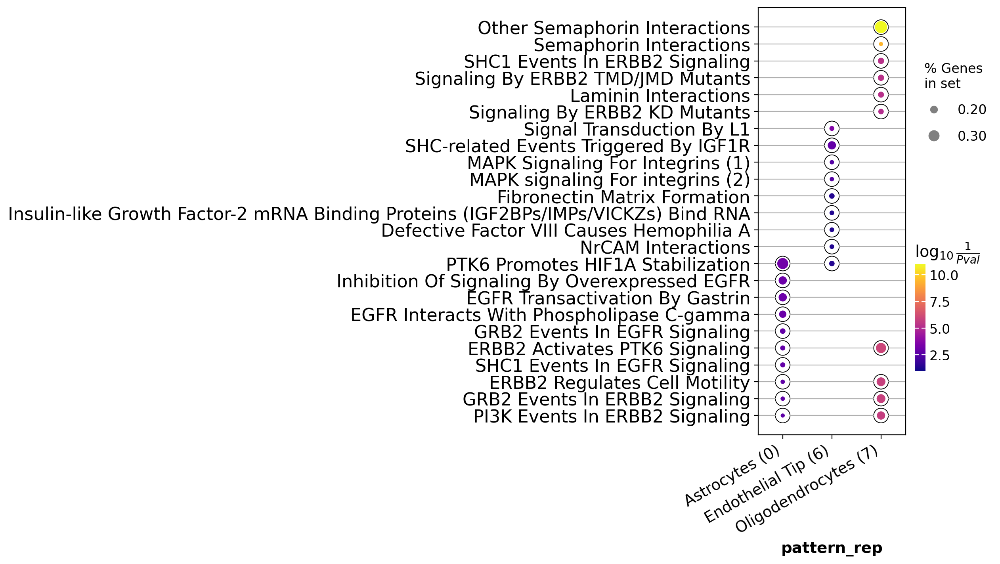

In [28]:
enrich_df_gene_reactome['Term_old'] = enrich_df_gene_reactome['Term']
enrich_df_gene_reactome['Term'] = [s.rsplit(' ', 1)[0] for s in enrich_df_gene_reactome['Term_old']]
enrich_df_gene_reactome['Term'] = enrich_df_gene_reactome['Term'].replace('p130Cas Linkage To MAPK Signaling For Integrins', 'MAPK Signaling For Integrins (1)')
enrich_df_gene_reactome['Term'] = enrich_df_gene_reactome['Term'].replace('GRB2:SOS Provides Linkage To MAPK Signaling For Integrins', 'MAPK signaling For integrins (2)')
enrich_df_gene_reactome['Term'] = enrich_df_gene_reactome['Term'].replace('Regulation Of Commissural Axon Pathfinding By SLIT And ROBO', 'Regulation Of Commissural Axon Pathfinding')
enrich_df_gene_reactome = enrich_df_gene_reactome[enrich_df_gene_reactome['Adjusted P-value']<0.05]
op.vis.enrichment(enrich_df_gene_reactome[(enrich_df_gene_reactome.label.isin(np.array(patterns, dtype=str))) & (enrich_df_gene_reactome['ratio'] > 0.12)], x_key='pattern_rep', size=5, figsize=(3,7), top_term=10, save=f'../figures/{ds}_{sample_name}_reactome_small.png')
op.vis.enrichment(enrich_df_gene_reactome[(enrich_df_gene_reactome.label.isin(np.array(patterns, dtype=str))) & (enrich_df_gene_reactome['ratio'] > 0.12)], x_key='pattern_rep', size=5, figsize=(3,10), top_term=10, save=f'../figures/{ds}_{sample_name}_reactome_large.png')
op.vis.enrichment(enrich_df_gene_reactome[(enrich_df_gene_reactome.label.isin(np.array(patterns, dtype=str))) & (enrich_df_gene_reactome['ratio'] > 0.12)], x_key='pattern_rep', size=5, figsize=(3,7), top_term=10)

In [29]:
sc.pp.neighbors(adata_pattern, n_neighbors=10, n_pcs=40, use_rep='X')


In [30]:
sc.tl.paga(adata_pattern)
sc.pl.paga(adata_pattern, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
sc.tl.umap(adata_pattern, init_pos='paga')
sc.tl.umap(adata_pattern)

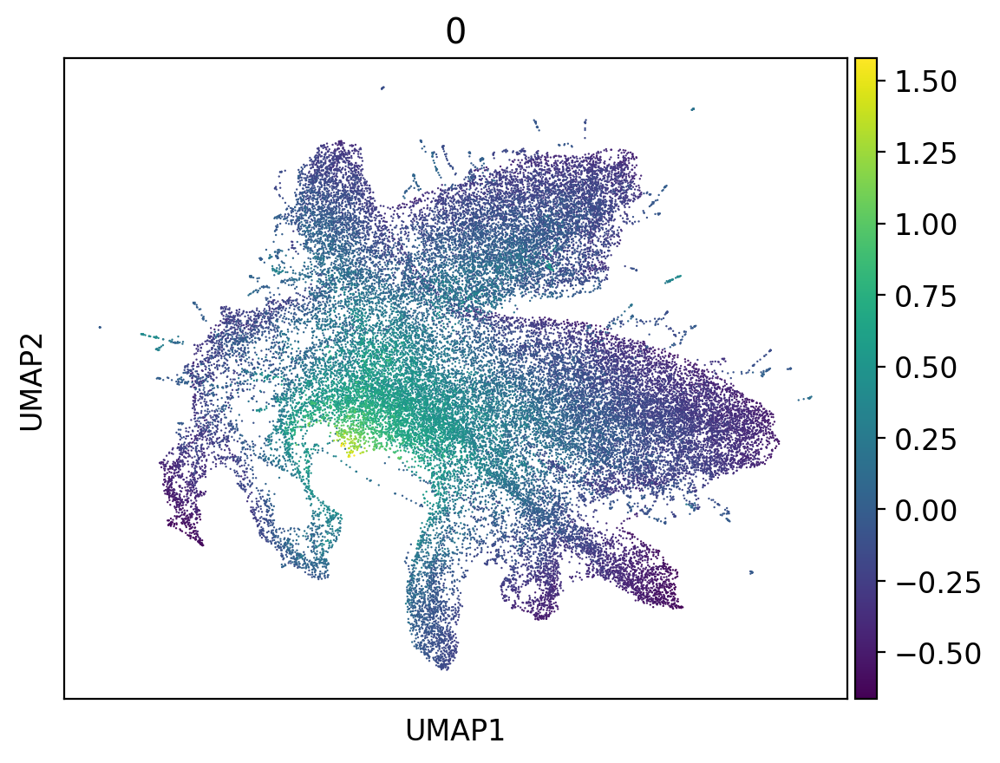

In [31]:
sc.pl.umap(adata_pattern, color=['0'])

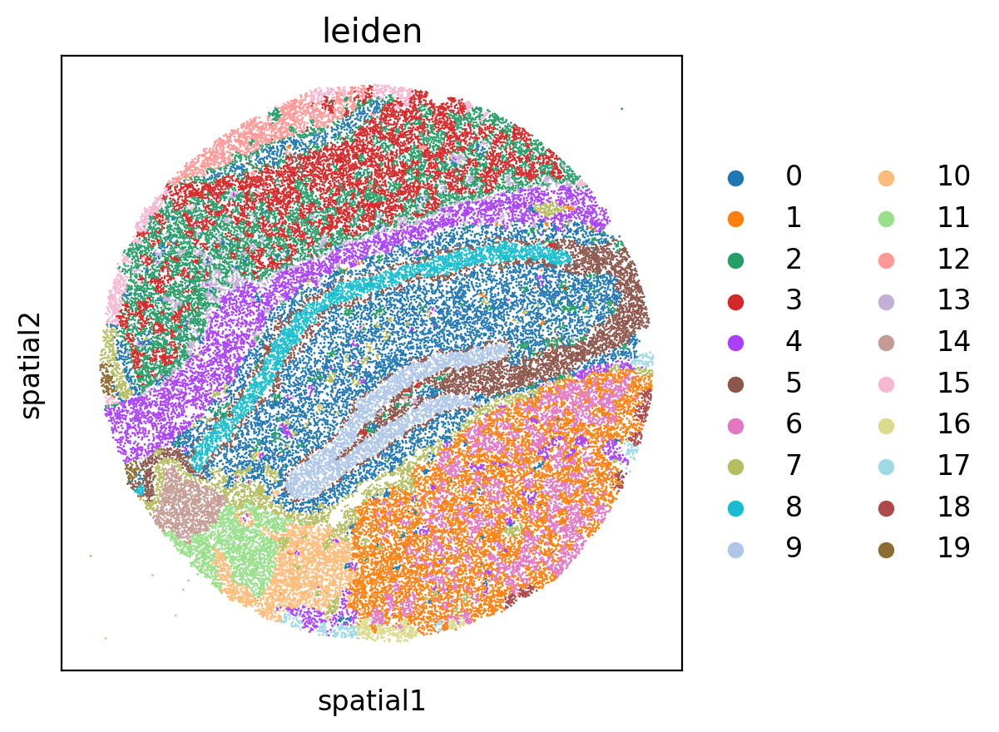

In [32]:
sc.tl.leiden(adata_pattern,resolution=0.5, seed=0)
# sc.pl.umap(adata_pattern, color=['leiden'])
main_clusters = adata_pattern.obs['leiden'].value_counts().index[adata_pattern.obs['leiden'].value_counts() > 100].to_numpy()
adata_pattern_subset = adata_pattern[adata_pattern.obs['leiden'].isin(main_clusters)]
sc.pl.spatial(adata_pattern_subset, color=['leiden'], spot_size=20)

In [33]:
pallete = {'0': '#1f77b4',
 '1': '#ff7f0e',
 '2': '#279e68',
 '3': '#d62728',
 '4': '#aa40fc',
 '5': '#8c564b',
 '6': '#e377c2',
 '7': '#b5bd61',
 '8': '#17becf',
 '9': '#aec7e8',
 '10': '#ffbb78',
 '11': '#98df8a',
 '12': '#ff9896',
 '18': '#c5b0d5',
 '14': '#c49c94',
 '15': '#f7b6d2',
 '16': '#dbdb8d',
 '17': '#9edae5',
 '13': '#ad494a',
 '19': '#8c6d31'}

(559.6379999999999, 5928.122, 520.558, 5835.802)

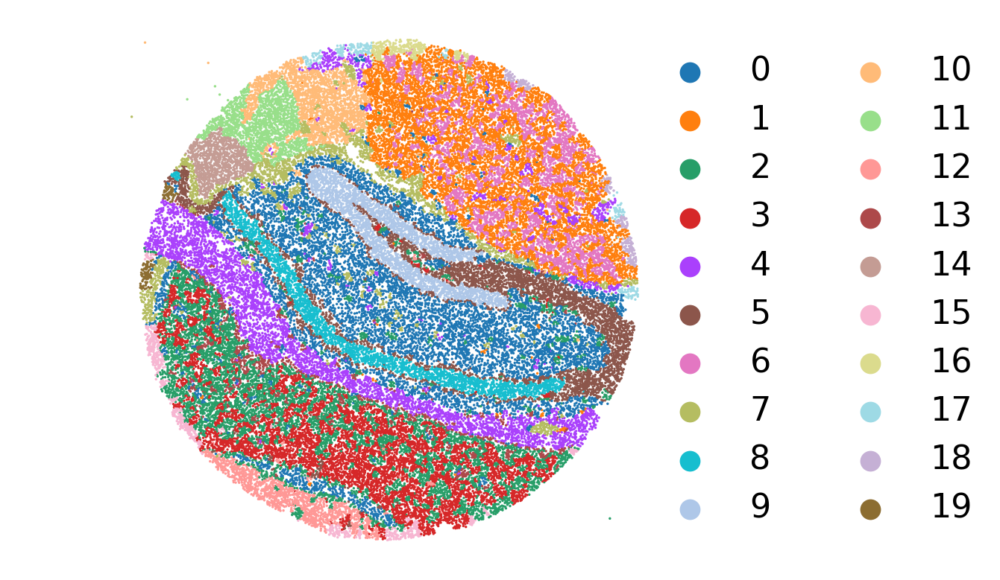

In [34]:
to_plot = pd.DataFrame(adata_pattern_subset.obs['leiden'])
to_plot[['x','y']] = adata_pattern_subset.obsm['spatial']
import seaborn as sns
# custom_palette = sns.color_palette("husl",to_plot.leiden.nunique())
sns.scatterplot(data=to_plot, x='x', y='y', hue='leiden', palette=pallete, s=1.5, linewidth=0, legend=True)
# move legend to right
plt.legend(bbox_to_anchor=(0.85, 0.95), loc=2, borderaxespad=0., ncols=2, frameon=False, fontsize=16, markerscale=1.5)
plt.axis('equal')
plt.axis('off')

In [35]:
dfs = []
for i in adata_pattern_subset.obs['leiden'].unique():
    dfs.append(adata_pattern_subset.obs['cluster'].loc[(adata_pattern_subset.obs[adata_pattern_subset.obs['leiden']==i]).index].value_counts())
dfs_merged = pd.concat(dfs, axis=1)
dfs_merged.columns=adata_pattern_subset.obs['leiden'].unique()
dfs_merged = (dfs_merged / dfs_merged.sum()).T.reset_index().rename(columns={'index':'interface cluster'}).sort_values('Astrocytes')


In [36]:
# get largest and second largest in each row of df
subset=dfs_merged[(dfs_merged.set_index('interface cluster').apply(lambda row: row.nlargest(2).values[-1],axis=1) >= 0.2).to_numpy()]
subset

,interface cluster,Astrocytes,CA1_CA2_CA3_Subiculum,DentatePyramids,Endothelial_Stalk,Endothelial_Tip,Ependymal,Interneurons,Microglia,Mural,Neurogenesis,Oligodendrocytes,Polydendrocytes,Subiculum_Entorhinal_cl2,Subiculum_Entorhinal_cl3
14,14,0.017266,0.028777,0.044604,0.102158,0.474820,0.221583,0.011511,0.037410,0.043165,0.011511,0.000000,0.001439,0.000000,0.005755
12,12,0.020085,0.280127,0.294926,0.026427,0.026427,0.002114,0.047569,0.019027,0.013742,0.026427,0.000000,0.021142,0.175476,0.046512
15,11,0.038394,0.158813,0.111693,0.026178,0.024433,0.207679,0.212042,0.013962,0.026178,0.041885,0.021815,0.041012,0.008726,0.067190
7,3,0.046885,0.208012,0.162448,0.026634,0.007484,0.001981,0.134933,0.015628,0.010346,0.014308,0.004402,0.018710,0.236408,0.111820
11,6,0.088523,0.206424,0.233059,0.040345,0.017626,0.000392,0.150020,0.014101,0.022718,0.012926,0.028594,0.028594,0.109283,0.047395
18,17,0.212121,0.075758,0.030303,0.030303,0.030303,0.000000,0.030303,0.020202,0.035354,0.020202,0.383838,0.060606,0.025253,0.045455


In [37]:
dfs_merged = dfs_merged[(dfs_merged.set_index('interface cluster').max(axis=1)>=0.3).to_numpy()]

In [38]:
dfs_merged

,interface cluster,Astrocytes,CA1_CA2_CA3_Subiculum,DentatePyramids,Endothelial_Stalk,Endothelial_Tip,Ependymal,Interneurons,Microglia,Mural,Neurogenesis,Oligodendrocytes,Polydendrocytes,Subiculum_Entorhinal_cl2,Subiculum_Entorhinal_cl3
1,8,0.016230,0.830836,0.083021,0.009988,0.004370,0.001873,0.029338,0.006242,0.003745,0.006242,0.001248,0.002497,0.003745,0.000624
14,14,0.017266,0.028777,0.044604,0.102158,0.474820,0.221583,0.011511,0.037410,0.043165,0.011511,0.000000,0.001439,0.000000,0.005755
9,9,0.017566,0.049561,0.831870,0.011920,0.008156,0.000627,0.013174,0.004391,0.005646,0.048306,0.001882,0.005019,0.000627,0.001255
3,5,0.090459,0.554308,0.154837,0.023110,0.013206,0.003632,0.063387,0.016177,0.016177,0.020139,0.009574,0.019478,0.008254,0.007263
6,4,0.107431,0.031106,0.020449,0.036002,0.015841,0.011809,0.022177,0.026210,0.019585,0.042627,0.569700,0.085541,0.004608,0.006912
10,13,0.128144,0.104192,0.051497,0.038323,0.013174,0.001198,0.108982,0.020359,0.022754,0.027545,0.311377,0.059880,0.019162,0.093413
18,17,0.212121,0.075758,0.030303,0.030303,0.030303,0.000000,0.030303,0.020202,0.035354,0.020202,0.383838,0.060606,0.025253,0.045455
5,0,0.395860,0.089918,0.127054,0.066056,0.026549,0.008375,0.064791,0.072377,0.033818,0.031606,0.018489,0.042826,0.012010,0.010272


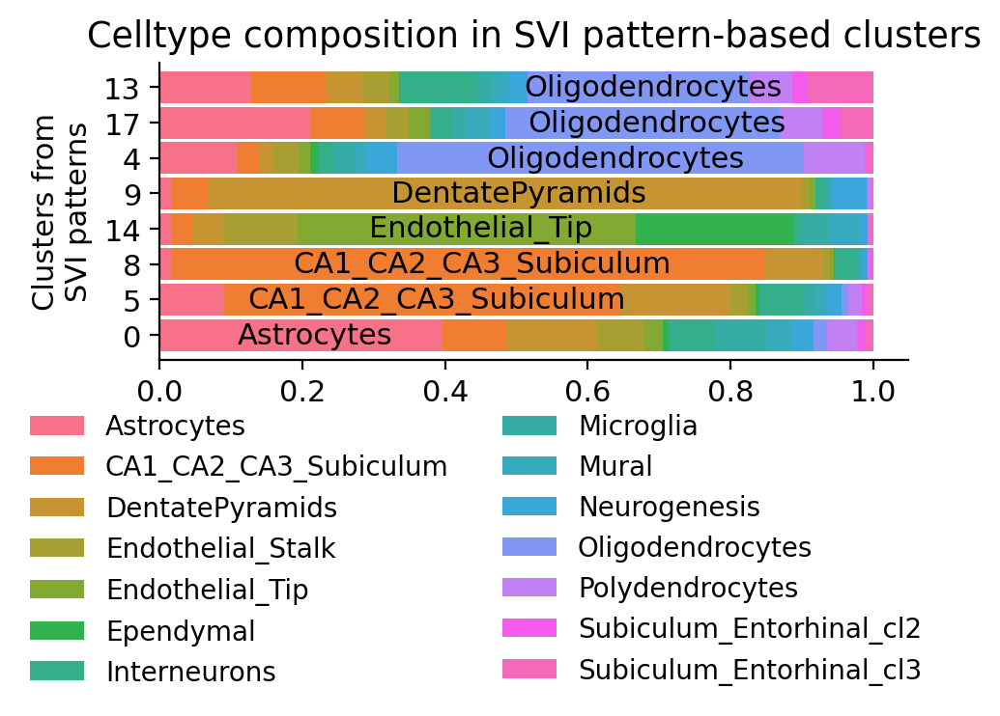

In [39]:
custom_palette = sns.color_palette("husl",adata_pattern_subset.obs['cluster'].nunique())
plt.rcParams['font.size'] = 11
g = dfs_merged.loc[[5, 3, 1, 14, 9, 6, 18, 10]].plot.barh(x='interface cluster',
        stacked=True, legend=False, color=custom_palette, figsize=(5,2), width=0.9)
g.spines[['right', 'top']].set_visible(False)
plt.ylabel('Clusters from\nSVI patterns')
plt.title('Celltype composition in SVI pattern-based clusters')
plt.legend(bbox_to_anchor=(1.05, -0.1), ncols=2, fontsize=10, frameon=False)
labels = []
for j in dfs_merged.columns:
    if j != 'interface cluster':
        for i in dfs_merged.index:
            label = j
            labels.append(label)
for label, p in zip(labels, g.patches):
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy() 
    if width>=0.3:
        # g.text(x,  y+height/2, 
        g.text(x+width/2+0.02,  y+height/2-0.01, 
                label, # '{:.0f} %'.format(height), 
                horizontalalignment='center', 
                verticalalignment='center',
                # rotation=90,
                )

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


(559.6379999999999, 5928.122, 520.558, 5835.802)

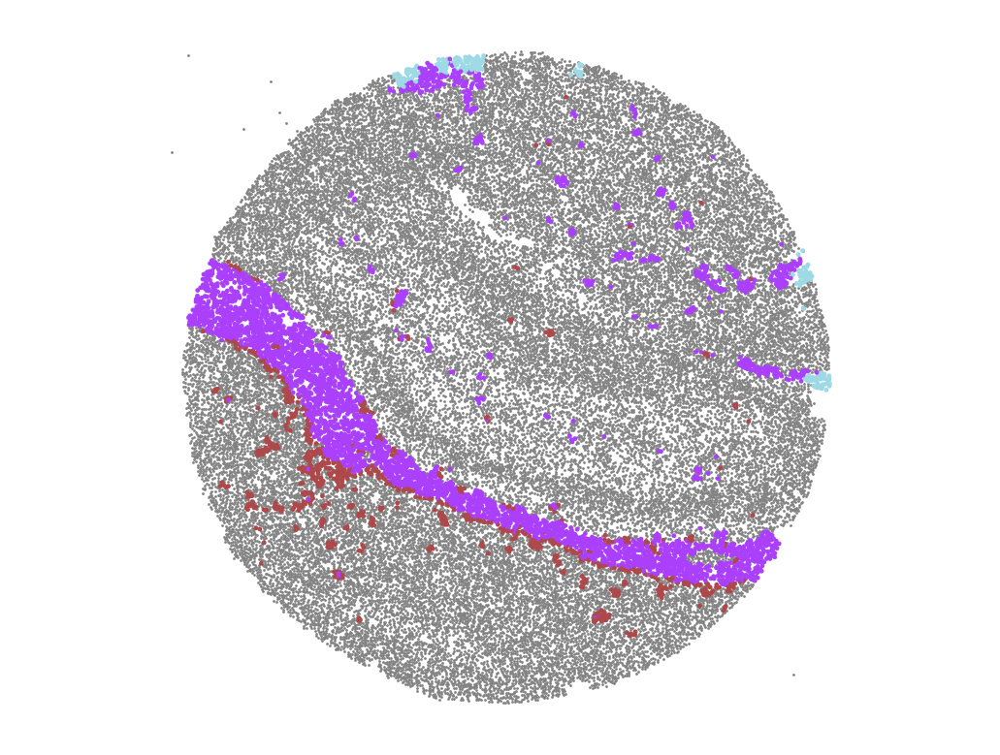

In [40]:
to_plot['leiden_oli'] = to_plot['leiden']
to_plot.loc[to_plot[~to_plot['leiden'].isin(['13', '17', '4'])].index, 'leiden_oli'] = np.nan
sns.scatterplot(data=to_plot, x='x', y='y', s=1, linewidth=0, legend=False, color='grey')
sns.scatterplot(data=to_plot, x='x', y='y', hue='leiden_oli', s=3, linewidth=0, legend=False, palette=pallete)
# move legend to right
plt.legend(bbox_to_anchor=(0.75, 1), loc=2, borderaxespad=0., ncols=1, frameon=False)
plt.axis('equal')
plt.axis('off')

{'mainplot_ax': <AxesSubplot: >,
 'gene_group_ax': <AxesSubplot: >,
 'size_legend_ax': <AxesSubplot: title={'center': 'Fraction of cells\nin group (%)'}>,
 'color_legend_ax': <AxesSubplot: title={'center': 'Mean expression\nin group'}>}

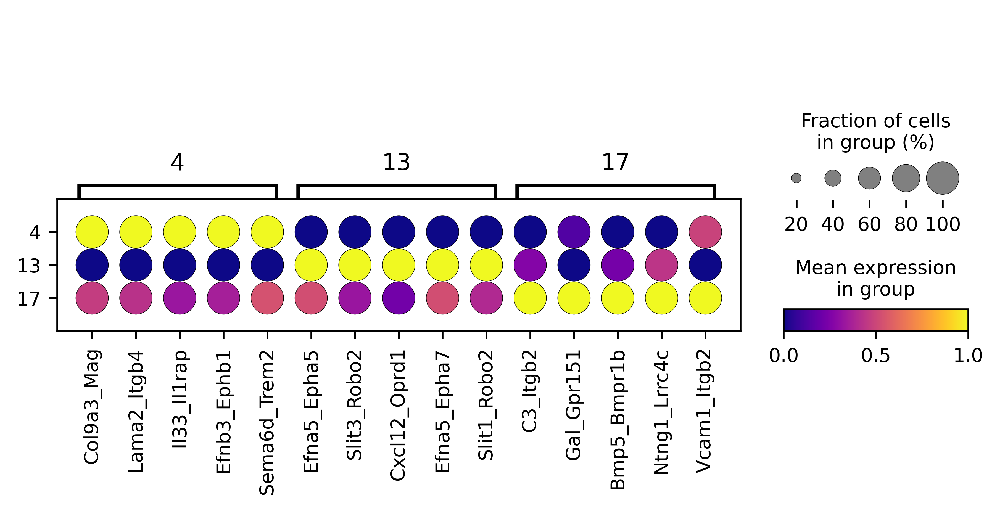

In [41]:
adata_lri.obs['leiden'] = adata_pattern.obs['leiden']
adata_lri_sub = adata_lri[adata_lri.obs['leiden'].isin(['13', '17', '4'])]
sc.tl.rank_genes_groups(adata_lri_sub, groupby='leiden')
sc.set_figure_params(dpi=300, fontsize=10)
sc.pl.rank_genes_groups_dotplot(adata_lri_sub, standard_scale='var', n_genes=5, show=False, dendrogram=False, color_map='plasma')

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


(559.6379999999999, 5928.122, 520.558, 5835.802)

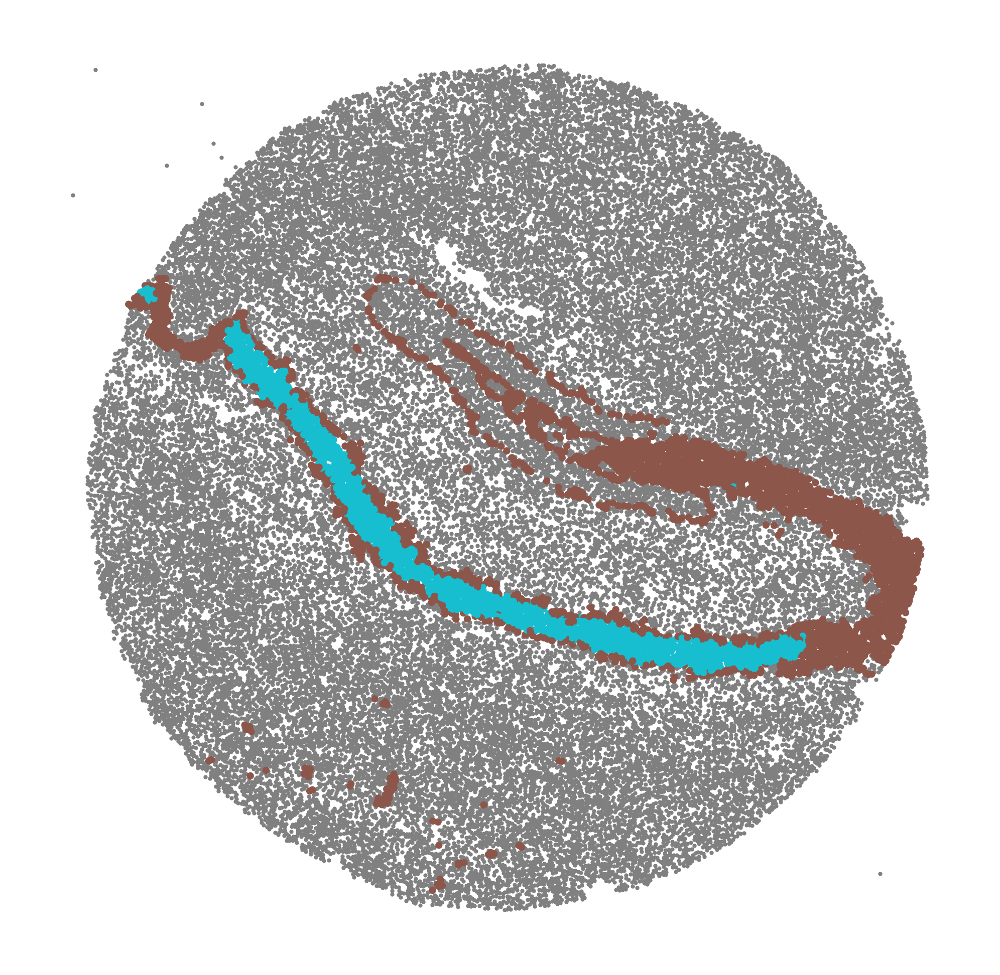

In [42]:
to_plot['leiden_ca'] = to_plot['leiden']
to_plot.loc[to_plot[~to_plot['leiden'].isin(['8', '5'])].index, 'leiden_ca'] = np.nan
sns.scatterplot(data=to_plot, x='x', y='y', s=1, linewidth=0, legend=False, color='grey')
sns.scatterplot(data=to_plot, x='x', y='y', hue='leiden_ca', s=3, linewidth=0, legend=False, palette=pallete)
# move legend to right
plt.legend(bbox_to_anchor=(0.75, 1), loc=2, borderaxespad=0., ncols=1, frameon=False)
plt.axis('equal')
plt.axis('off')

{'mainplot_ax': <AxesSubplot: >,
 'gene_group_ax': <AxesSubplot: >,
 'size_legend_ax': <AxesSubplot: title={'center': 'Fraction of cells\nin group (%)'}>,
 'color_legend_ax': <AxesSubplot: title={'center': 'Mean expression\nin group'}>}

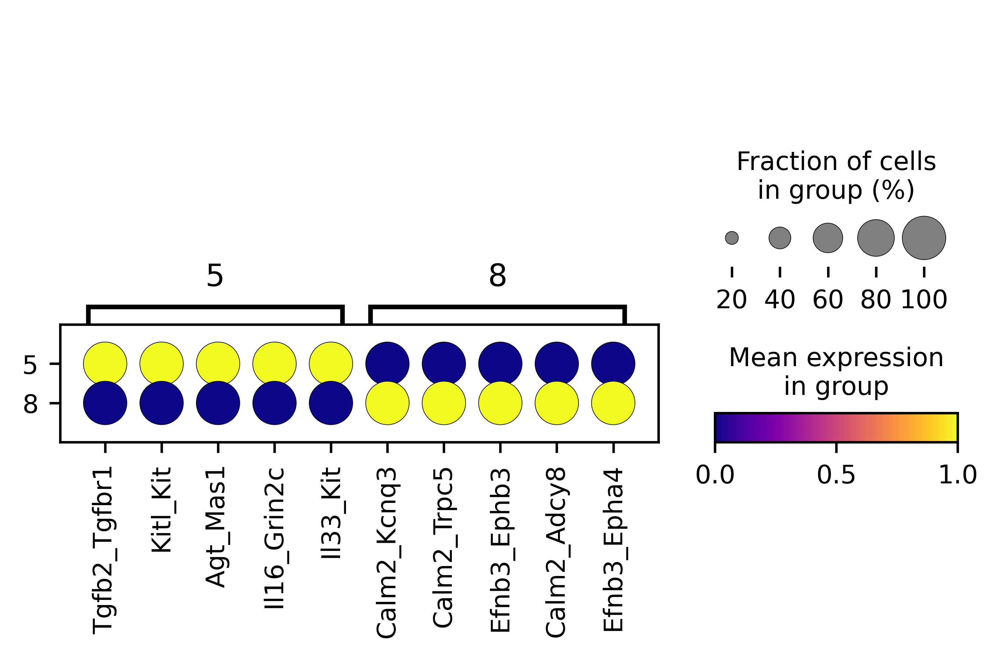

In [43]:
adata_lri.obs['leiden'] = adata_pattern.obs['leiden']
adata_lri_sub = adata_lri[adata_lri.obs['leiden'].isin(['8', '5'])]
sc.tl.rank_genes_groups(adata_lri_sub, groupby='leiden')
sc.set_figure_params(dpi=300, fontsize=10)
sc.pl.rank_genes_groups_dotplot(adata_lri_sub, standard_scale='var', n_genes=5, show=False, dendrogram=False, color_map='plasma')